In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import decoupler as dc
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats
from itertools import combinations
import anndata
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import random
#import scvi

import plotting_functions as pf

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [2]:
plate_palette = sns.color_palette("husl", n_colors=3)
sex_palette = ['hotpink','dodgerblue']
geno_palette = ['#DA9CC1', '#F4C245', '#C0BFBF', '#55AF5B', '#4F6EAF', '#52A5DB', '#D83026', '#683C91']


# QC plotting - filtered data
500 UMI, 250 genes, 1% mito, 0.25 doublet score


In [3]:
adata = sc.read("../IGVF_analysis/HypothalamusPituitary_processed.h5ad")


In [4]:
adata.layers

Layers with keys: raw_counts

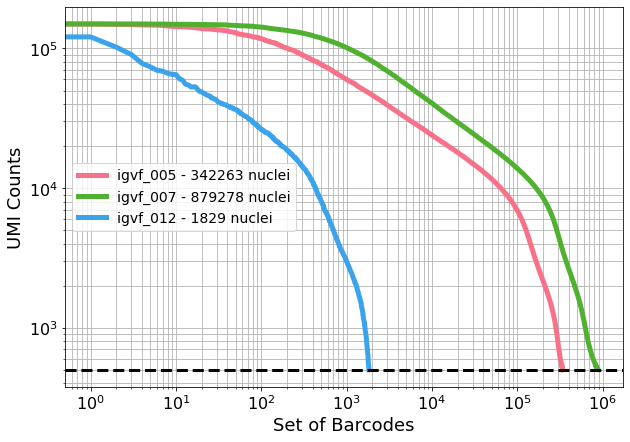

In [5]:
pf.plot_knee(adata, cutoff=500, category_column='plate', figsize=(10, 7))
plt.show()

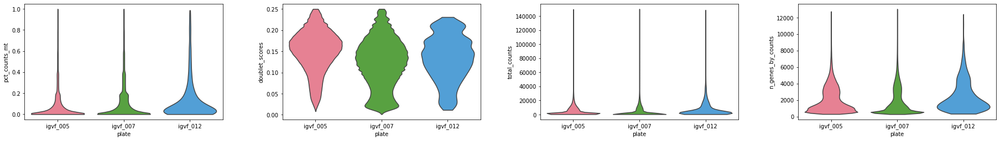

In [6]:
sc.pl.violin(adata, ['pct_counts_mt', 'doublet_scores', 'total_counts', 'n_genes_by_counts'],
             groupby = "plate", palette = plate_palette,
             jitter=0.4, multi_panel=True, size=0)

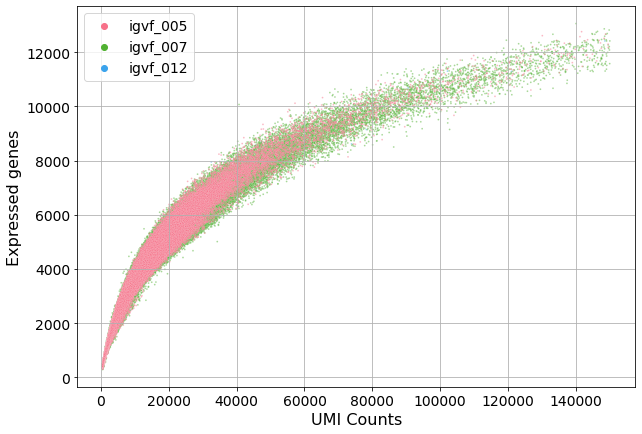

In [7]:
pf.plot_genes_by_counts(adata, category_column='plate', figsize=(10, 7))
plt.show()

In [8]:
print(adata.obs['Genotype'].value_counts())

adata = adata[adata.obs['Genotype'] != "tie",:]

print(adata.obs['Genotype'].value_counts())

PWKJ      195015
NODJ      192497
B6J       176117
NZOJ      143261
AJ        140225
WSBJ      127298
CASTJ     125127
129S1J    122969
tie          864
Name: Genotype, dtype: int64
PWKJ      195015
NODJ      192497
B6J       176117
NZOJ      143261
AJ        140225
WSBJ      127298
CASTJ     125127
129S1J    122969
Name: Genotype, dtype: int64


In [9]:
adata

View of AnnData object with n_obs × n_vars = 1222509 × 56953
    obs: 'bc', 'bc1_sequence', 'bc2_sequence', 'bc3_sequence', 'subpool', 'bc1_well', 'bc2_well', 'bc3_well', 'Mouse_Tissue_ID', 'alias_tissue1', 'alias_tissue2', 'alias_tissue3', 'alias_tissue4', 'plate', 'Protocol', 'Chemistry', 'well_type', 'Row', 'Column', 'Genotype', 'Notes', 'Multiplexed_sample1', 'Multiplexed_sample2', 'SampleType', 'Tissue', 'Tissue_ID', 'Tissue1_ontology_id', 'Tissue2_ontology_id', 'Sex', 'Replicate', 'DOB', 'Age_weeks', 'Age_days', 'Body_weight_g', 'Estrus_cycle', 'Dissection_date', 'Dissection_time', 'Dissector', 'Tissue_weight_mg', 'mult_genotype_1', 'mult_genotype_2', 'mult_genotype', 'n_counts', 'doublet_scores', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_name', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'l

# Check clustering
Plate, sex, genotype

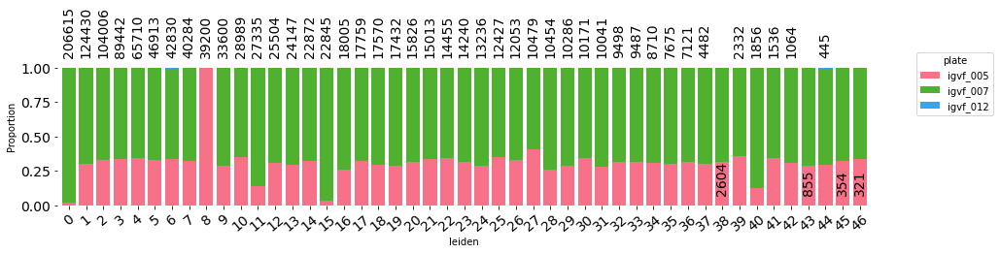

In [10]:
pf.stacked_barplot_proportions(adata.obs, 
                            'leiden', 'plate',
                            flip=False, fsize = (15,3), 
                            annotations = True)


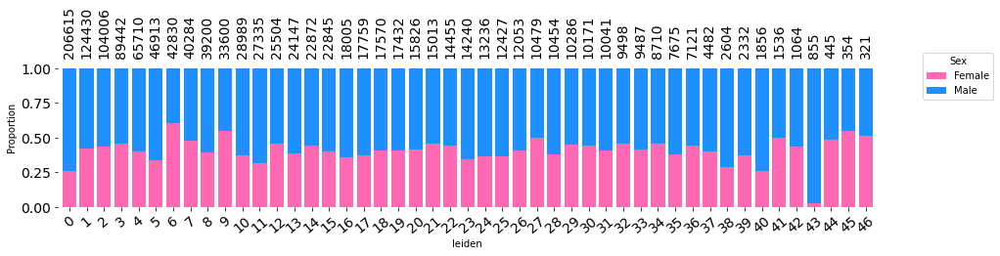

In [11]:
pf.stacked_barplot_proportions(adata.obs, 
                            'leiden', 'Sex',
                            flip=False, fsize = (15,3), 
                            annotations = True)


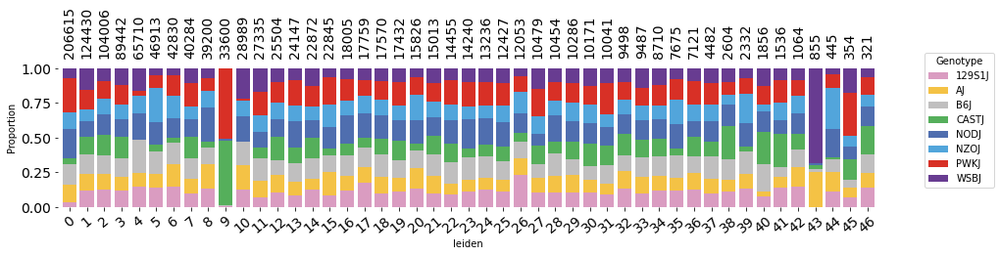

In [12]:
pf.stacked_barplot_proportions(adata.obs, 
                            'leiden', 'Genotype',
                            flip=False, fsize = (15,3), 
                            annotations = True)


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/Users/liz/opt/anaconda3/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


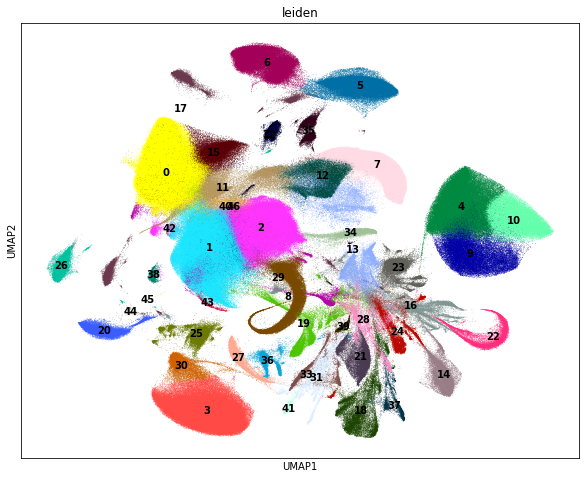

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


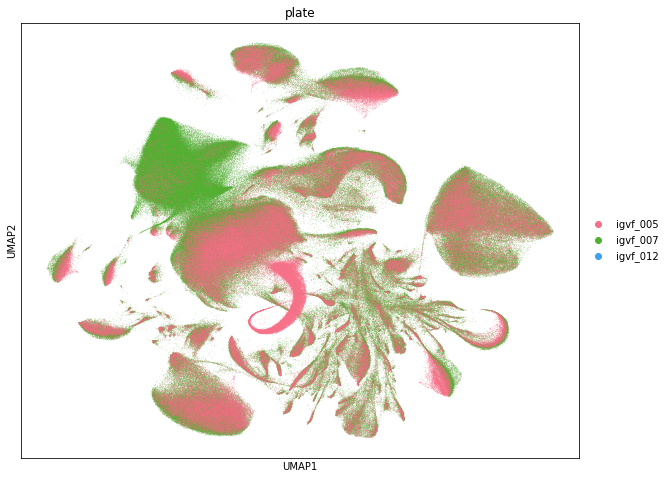

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


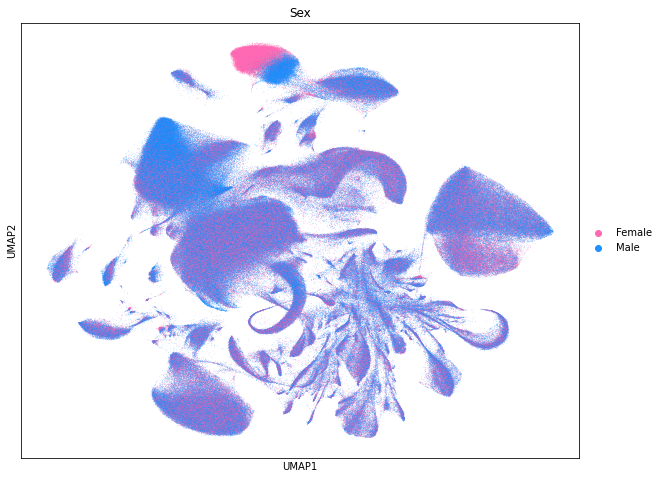

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


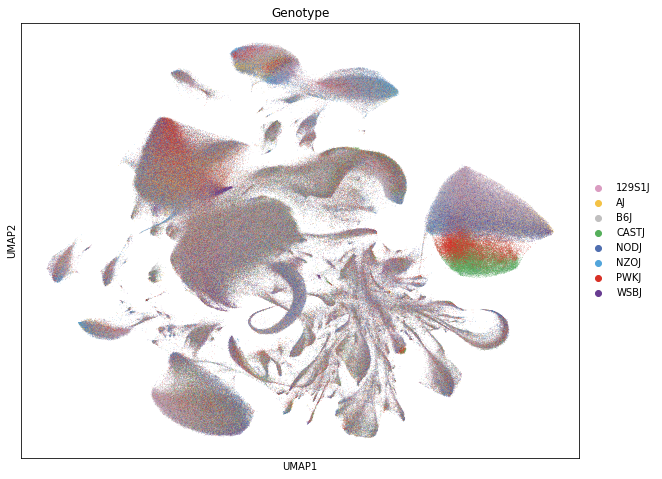

In [13]:
plt.rcParams['figure.figsize'] = (10, 8)

sc.pl.umap(adata, color=['leiden'], size=1, legend_loc = 'on data')

sc.pl.umap(adata, color=['plate'], size = 0.8, palette = plate_palette)

sc.pl.umap(adata, color=['Sex'], size = 0.8, palette = sex_palette)

sc.pl.umap(adata, color=['Genotype'], size = 0.8, palette = geno_palette)



/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


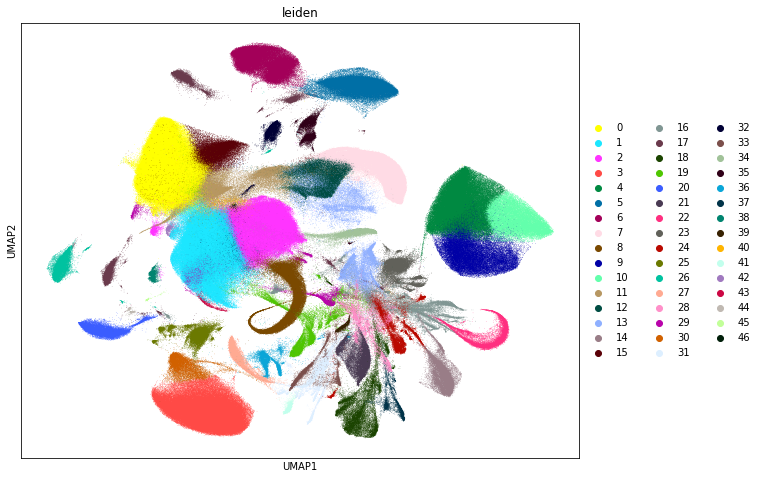

In [17]:
sc.pl.umap(adata, color=['leiden'], size=1)


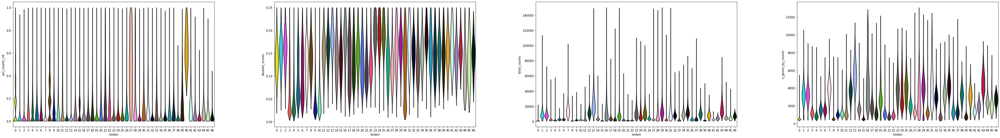

In [14]:
sc.pl.violin(adata, ['pct_counts_mt', 'doublet_scores', 'total_counts', 'n_genes_by_counts'],
             groupby = "leiden", 
             jitter=0.4, multi_panel=True, size=0)

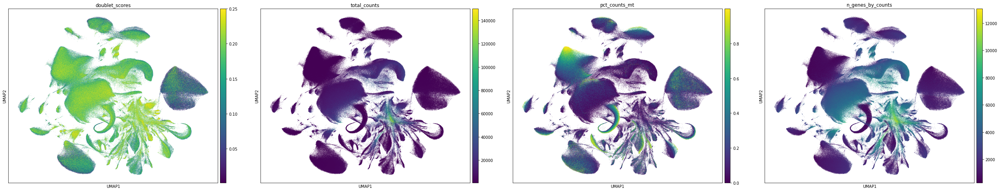

In [15]:
sc.pl.umap(adata, color=['doublet_scores','total_counts','pct_counts_mt','n_genes_by_counts'], size=1)


In [16]:
adata.var_names  = adata.var['gene_name']


# Remove large low-quality clusters and re-cluster

In [ ]:
adata = adata[~adata.obs['leiden'].isin(["0","15","11","8"])] # 926616 remaining



In [ ]:
adata.uns['log1p']["base"] = None


In [ ]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

adatas = adata[:, adata.var.highly_variable]



In [ ]:
sc.pp.regress_out(adatas, ['pct_counts_mt','n_genes_by_counts'])
sc.pp.scale(adatas, max_value=10)

sc.tl.pca(adatas, svd_solver='arpack', use_highly_variable = True)
sc.pp.neighbors(adatas, n_neighbors=20, n_pcs=30)

sc.tl.leiden(adatas, resolution = 1)

In [ ]:
sc.tl.umap(adatas, min_dist = 0.5, spread =2.0)

In [ ]:
adata.uns['neighbors'] = adatas.uns['neighbors']
adata.uns['leiden'] = adatas.uns['leiden']
adata.uns['umap'] = adatas.uns['umap']
adata.obs['leiden'] = adatas.obs['leiden']
adata.obsm = adatas.obsm
adata.obsp = adatas.obsp



In [ ]:
adata.write_h5ad('../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad')


# Label transfer from ENC4 brain data


## Merge and preprocess

In [ ]:
adata = sc.read('../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad')


In [ ]:
ref_data = sc.read("../IGVF_analysis/external_ref/enc4_parse_pnm02_cortexhippocampus.h5ad")
ref_data.layers["raw_counts"] = ref_data.X.copy()

In [ ]:
adata.var_names  = adata.var['gene_name']


In [ ]:
adata.obs['batch'] = 'query'
ref_data.obs['batch'] = 'reference'

In [ ]:
adata = adata.concatenate(ref_data)


In [ ]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata


In [ ]:
sc.pp.highly_variable_genes(adata, flavor = 'seurat_v3', n_top_genes=2000,
                            layer = "raw_counts", batch_key="batch", subset = True)



## Also try whole brain from Linnarsson lab

http://mousebrain.org/

In [ ]:
data = sc.read_mtx("/dfs5/bio/erebboah/snrna/5xfad_cast_brain/ref/mousebrain_adolescent_matrix.mtx")
  
obs = pd.read_csv("/dfs5/bio/erebboah/snrna/5xfad_cast_brain/ref/mousebrain_adolescent_obs.csv")
obs = obs[['CellID', 'ClusterName']]

var = pd.read_csv("/dfs5/bio/erebboah/snrna/5xfad_cast_brain/ref/mousebrain_adolescent_genes.csv")

X = data.X
ref_data = anndata.AnnData(X=X, obs=obs, var=var)

ref_data.var_names  = ref_data.var['Gene']
ref_data.var_names_make_unique()

ref_data.layers["raw_counts"] = ref_data.X.copy()

ref_data.obs['batch'] = 'reference'

ref_data.write_h5ad('/dfs5/bio/erebboah/snrna/5xfad_cast_brain/ref/mousebrain_adolescent.h5ad')


## Merge and preprocess

In [ ]:
ref_data = sc.read("/dfs5/bio/erebboah/snrna/5xfad_cast_brain/ref/mousebrain_adolescent.h5ad")


In [ ]:
adata = sc.read('../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad')
adata.obs['batch'] = 'query'
adata.var_names  = adata.var['gene_name']
adata.var_names_make_unique()

In [ ]:
adata = adata.concatenate(ref_data)


In [ ]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata


In [ ]:
sc.pp.highly_variable_genes(adata, flavor = 'seurat_v3', n_top_genes=2000,
                            layer = "raw_counts", batch_key="batch", subset = True)



# Run scvi
Same code for both ENC4 and Linnarsson data EXCEPT the obs (`subtypes` for ENC4, `ClusterName` for Linnarsson). Used `predictions` key for ENC4 and `predictions_mousebrain` for Linnarsson data, not well named

In [ ]:
scvi.model.SCVI.setup_anndata(adata, layer = 'raw_counts', batch_key='batch')
vae = scvi.model.SCVI(adata)
vae.train()


In [ ]:
adata.obs['ClusterName'] = adata.obs['ClusterName'].cat.add_categories('Unknown')
adata.obs = adata.obs.fillna(value = {'ClusterName': 'Unknown'})



In [ ]:
lvae = scvi.model.SCANVI.from_scvi_model(vae, adata = adata, unlabeled_category = 'Unknown',
                                        labels_key = 'ClusterName')

lvae.train(max_epochs=20, n_samples_per_label=100)

adata.obs['predictions_mousebrain'] = lvae.predict(adata)


In [ ]:
adata.obs['cell_barcodes'] = adata.obs.index.map(lambda x: x[:-2])

cell_mapper = dict(zip(adata.obs.cell_barcodes, adata.obs.predictions_mousebrain))

In [ ]:
# df_cell_mapper = pd.DataFrame(list(cell_mapper.items()), columns=['cell_barcodes', 'predictions_mousebrain'])

# df_cell_mapper.to_csv('hypopit_cell_mapper.csv', index=False)

## Map back onto original adata

In [ ]:
adata = sc.read("../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad")


In [ ]:
adata.obs['predictions_mousebrain'] = adata.obs.index.map(cell_mapper)


In [ ]:
adata.write_h5ad('../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad')


In [ ]:
adata = sc.read("../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad")


In [ ]:
color_palette = sns.color_palette("husl", n_colors=30)

plt.rcParams['figure.figsize'] = (10, 8)


sc.pl.umap(adata, color=['predictions_mousebrain'], size=1, legend_loc = 'on data',palette=color_palette)



In [ ]:
sc.pl.umap(adata, color=['predictions_mousebrain'], size=1, palette=color_palette)


# Check clustering


In [79]:
adata = sc.read("../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad")


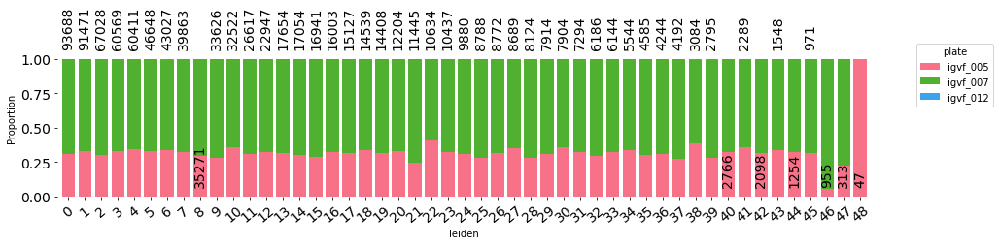

In [15]:
pf.stacked_barplot_proportions(adata.obs, 
                            'leiden', 'plate',
                            flip=False, fsize = (15,3), 
                            annotations = True)


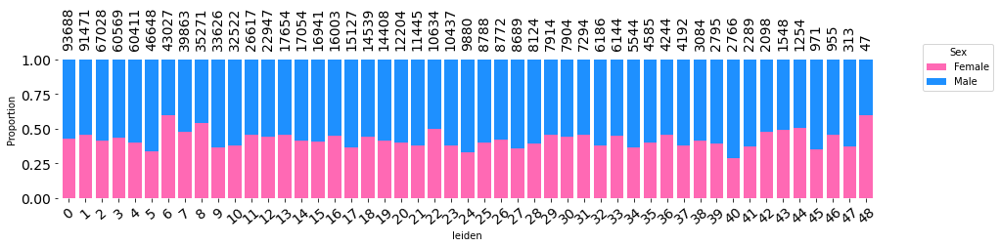

In [16]:
pf.stacked_barplot_proportions(adata.obs, 
                            'leiden', 'Sex',
                            flip=False, fsize = (15,3), 
                            annotations = True)


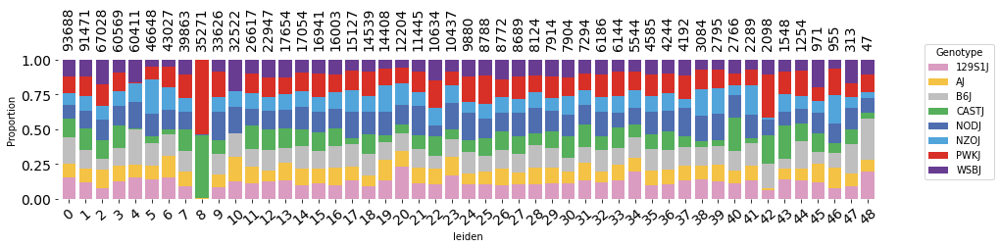

In [17]:
pf.stacked_barplot_proportions(adata.obs, 
                            'leiden', 'Genotype',
                            flip=False, fsize = (15,3), 
                            annotations = True)


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


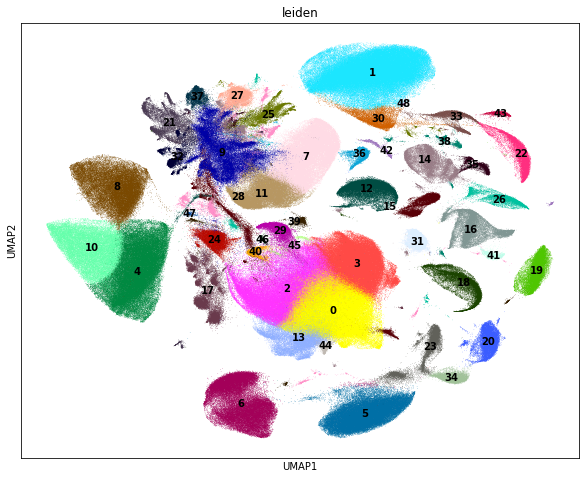

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


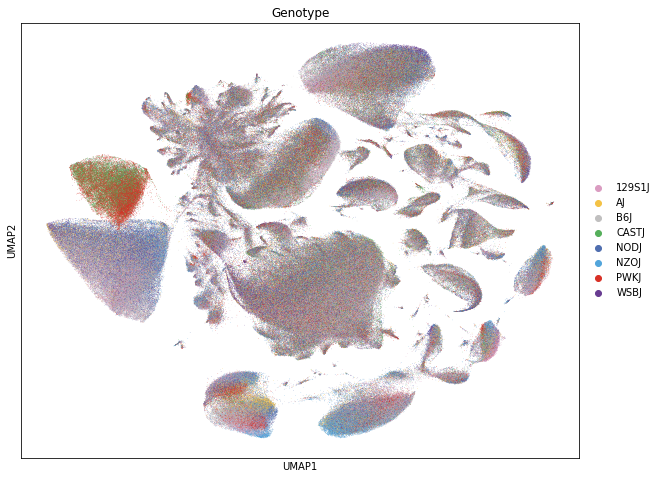

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


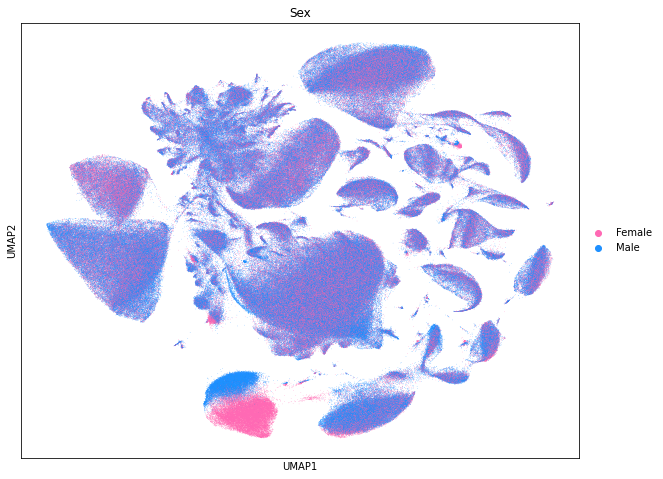

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


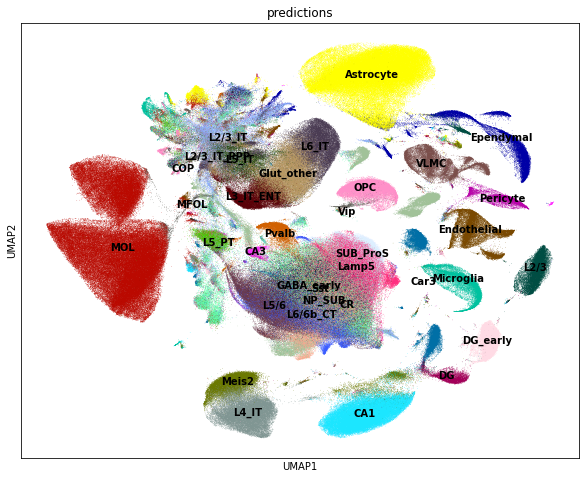

In [20]:

plt.rcParams['figure.figsize'] = (10, 8)

sc.pl.umap(adata, color=['leiden'], size=1, legend_loc = 'on data')

sc.pl.umap(adata, color=['Genotype'], size=1, palette = geno_palette)

sc.pl.umap(adata, color=['Sex'], size=1, palette = sex_palette)

sc.pl.umap(adata, color=['predictions'], size=1, legend_loc = 'on data')



/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


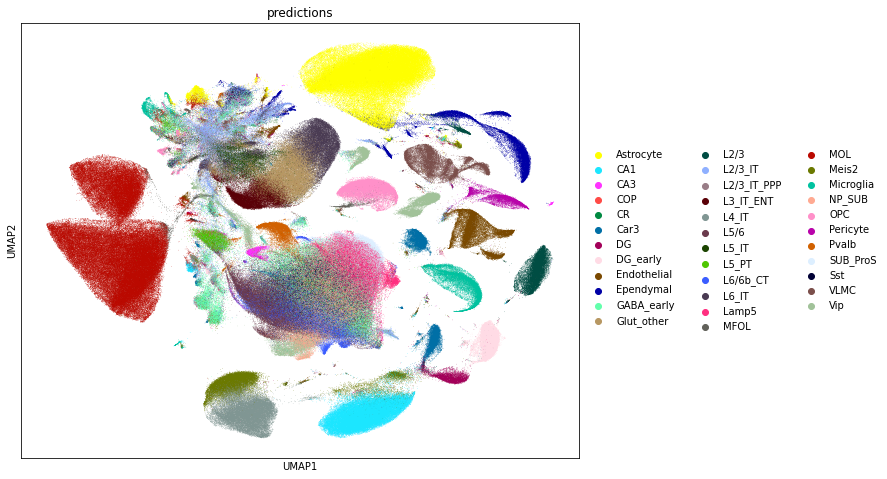

In [93]:
sc.pl.umap(adata, color=['predictions'], size=1)


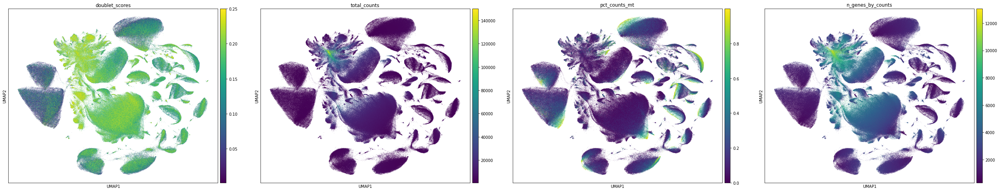

In [53]:
sc.pl.umap(adata, color=['doublet_scores','total_counts','pct_counts_mt','n_genes_by_counts'], size=1)


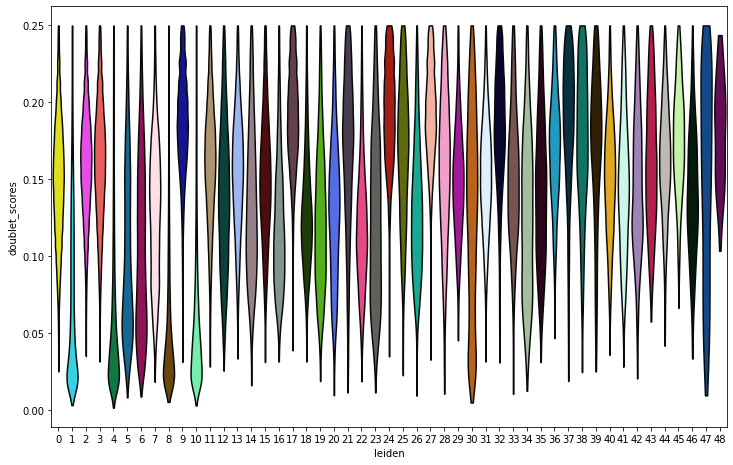

In [54]:
sc.pl.violin(adata, ['doublet_scores'],
             groupby = "leiden", 
             jitter=0.4, multi_panel=True, size=0)

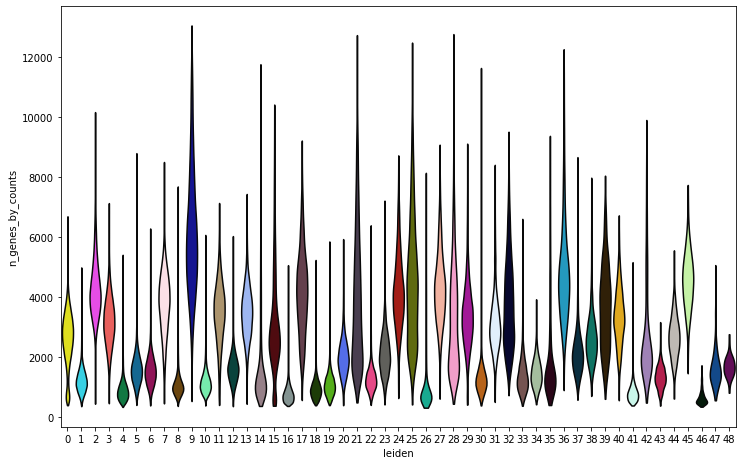

In [55]:
sc.pl.violin(adata, ['n_genes_by_counts'],
             groupby = "leiden", 
             jitter=0.4, multi_panel=True, size=0)

# Check marker gene expression

In [24]:
adata.var_names  = adata.var['gene_name']


In [29]:
markers_df = pd.read_csv("IGVF_curated_markers.csv")
markers_df = markers_df[markers_df['Tissue'] == 'HypothalamusPituitary']
markers_df = markers_df[markers_df['Gene'].isin(adata.var_names)]

marker_genes_dict = {}

for index, row in markers_df.iterrows():
    gene = row['Gene']
    subtype = row['Subtype']

    if subtype not in marker_genes_dict:
        marker_genes_dict[subtype] = [gene]
    else:
        marker_genes_dict[subtype].append(gene)

categories: 0, 1, 2, etc.
var_group_labels: Astrocyte, Corticotrope, Endothelial, etc.


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


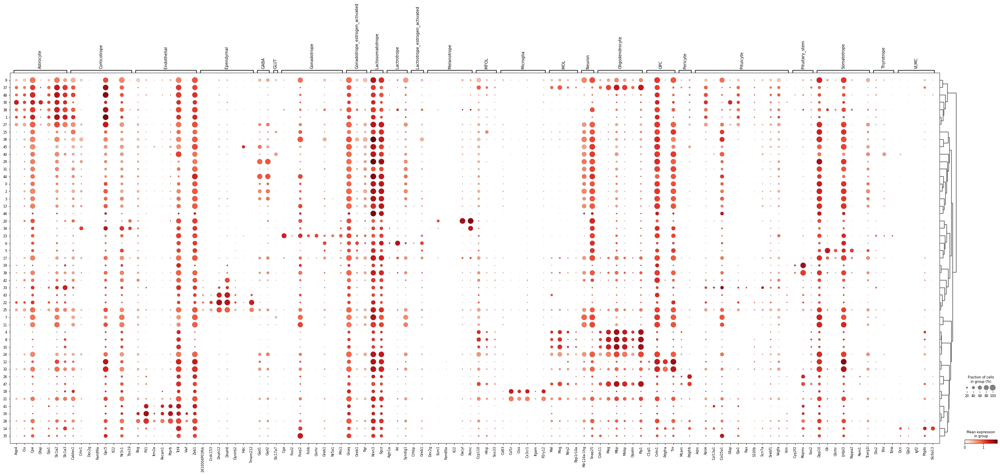

In [30]:
sc.pl.dotplot(adata, marker_genes_dict, 'leiden', mean_only_expressed = True,
              dendrogram=True, log=True)


categories: 0, 1, 2, etc.
var_group_labels: Endothelial, Pericyte, Fibroblast, etc.


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


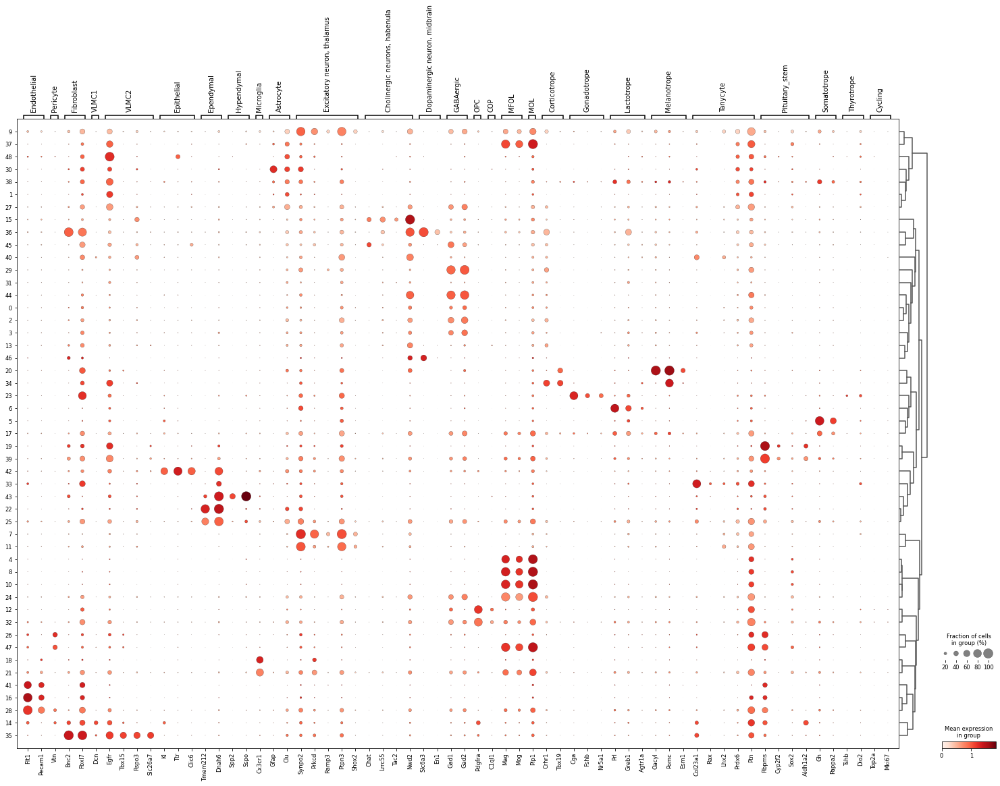

In [178]:
smol_marker_genes_dict = {
    "Endothelial": ["Flt1","Pecam1"],
    "Pericyte": ["Vtn"],
    "Fibroblast": ["Bnc2","Fbxl7"],
    "VLMC1": ["Dcn"],
    "VLMC2": ['Egfr','Tbx15','Rspo3','Slc26a7'],
    "Epithelial":["Kl","Ttr","Clic6"], # http://mousebrain.org/celltypes/CHOR.html
    "Ependymal":["Tmem212","Dnah6"],
    "Hypendymal":['Spp2','Sspo'], # http://mousebrain.org/celltypes/HYPEN.html
    "Microglia": ["Cx3cr1"],
    "Astrocyte": ["Gfap","Clu"],
    "Excitatory neuron, thalamus": ["Synpo2","Prkcd","Ramp3","Ptpn3","Shox2"], #http://mousebrain.org/celltypes/DEGLU1.html
    "Cholinergic neurons, habenula": ['Chat','Lrrc55','Tac2','Nwd2'],
    "Dopaminergic neuron, midbrain": ["Slc6a3","En1"], # http://mousebrain.org/celltypes/MBDOP2.html
    "GABAergic": ["Gad1","Gad2"],
    "OPC": ["Pdgfra"],
    "COP": ["C1ql1"],
    "MFOL": ["Mag","Mog"],
    "MOL": ["Plp1"],
    "Corticotrope": ["Crhr1","Tbx19"],
    "Gonadotrope": ["Cga","Fshb","Nr5a1"],
    "Lactotrope": ["Prl","Greb1","Agtr1a"],
    "Melanotrope": ["Oacyl","Pomc","Esm1"],
    "Tanycyte": ['Col23a1','Rax','Lhx2','Prdx6','Ptn'],
    "Pituitary_stem": ["Rbpms","Cyp2f2","Sox2","Aldh1a2"],
    "Somatotrope": ["Gh","Pappa2"],
    "Thyrotrope": ["Tshb","Dio2"],
    "Cycling": ["Top2a","Mki67"],
}



sc.pl.dotplot(adata, smol_marker_genes_dict, 'leiden', mean_only_expressed = True,
              dendrogram=True, log=True)


# Find cluster markers

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame is highly 

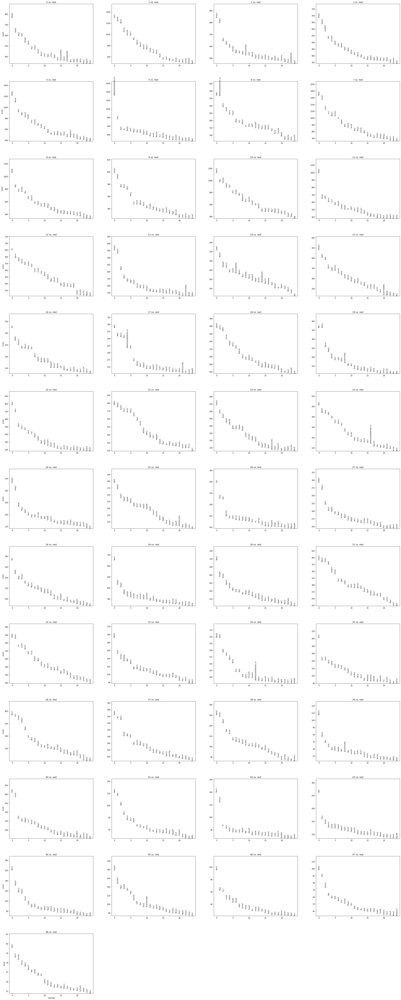

In [51]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)



In [52]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
result = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']})


In [56]:
result.to_csv("hypopit_cluster_markers.csv")


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


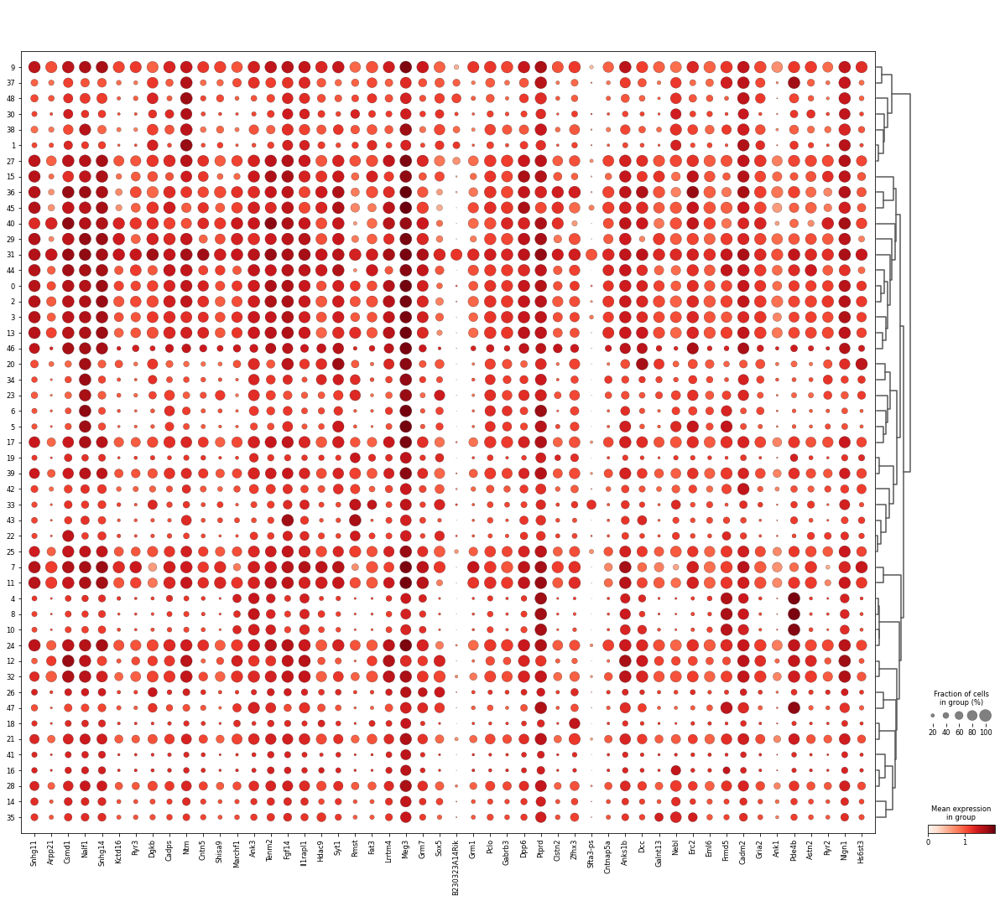

In [199]:
adata.var_names  = adata.var['gene_name']

top_markers = result['31_n'].head(50).tolist()
#top_markers = result['31_n'].head(100).tolist()[50:100]
sc.pl.dotplot(adata, top_markers, 'leiden', mean_only_expressed = True,
              dendrogram=True, log=True)


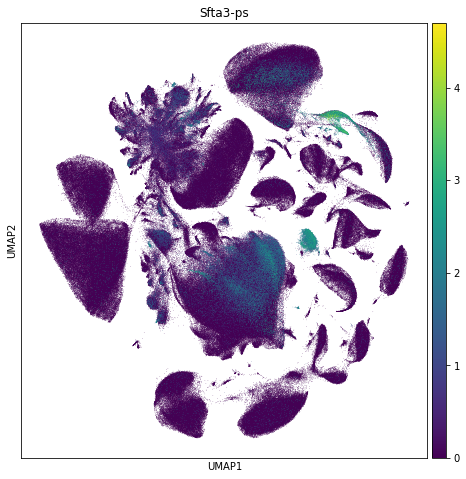

In [208]:
sc.pl.umap(adata, color=['Sfta3-ps'], size=1)



# Get Ryan's annotations

In [ ]:
ref_adata = sc.read("../IGVF_analysis/annotated_tissues/ryan_annotations/Hypthalamus_Pituitary_annotated.h5ad")
ref_adata.obs['cell_barcodes'] = ref_adata.obs.index.map(lambda x: x[:-2])

cell_mapper = dict(zip(ref_adata.obs.cell_barcodes, ref_adata.obs.cell_types))

adata.obs['ryan_annotations'] = adata.obs.index.map(cell_mapper)


In [ ]:
adata.write_h5ad('../IGVF_analysis/annotated_tissues/HypothalamusPituitary_filtered.h5ad')


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


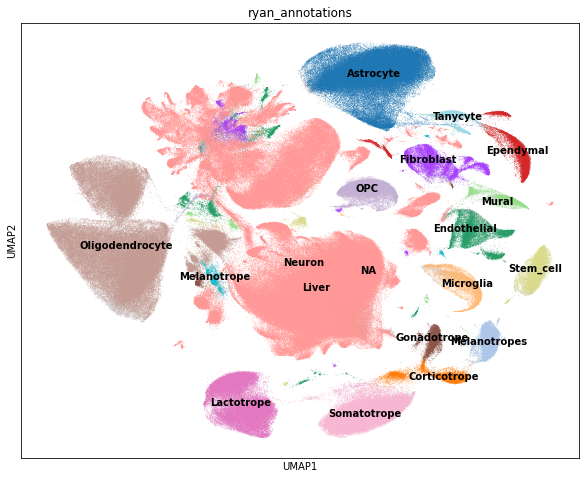

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


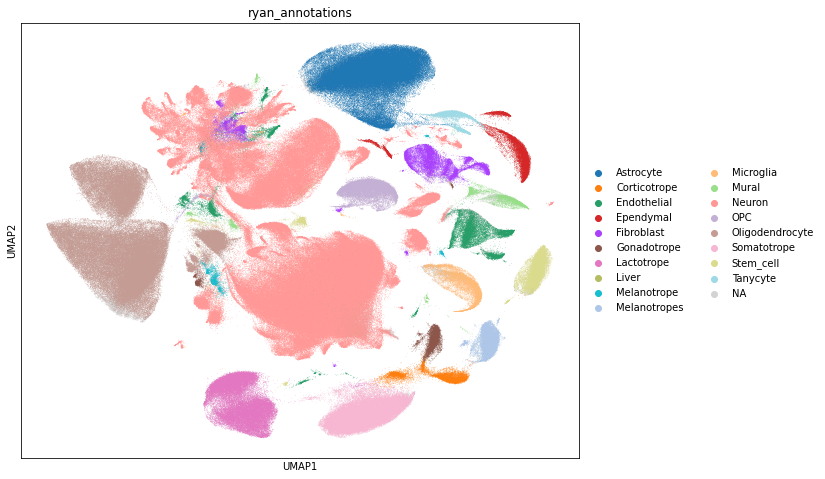

In [81]:
plt.rcParams['figure.figsize'] = (10, 8)

sc.pl.umap(adata, color=['ryan_annotations'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['ryan_annotations'], size=1)


In [83]:
adata.obs['ryan_annotations'].isna().sum()

24827

# Subcluster
23 probably has thyrotrope

In [222]:
sc.tl.leiden(adata, restrict_to = ('leiden',['23']), resolution = 0.05)
adata.obs['leiden_R'] = adata.obs['leiden_R'].str.replace(',', '_')



/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


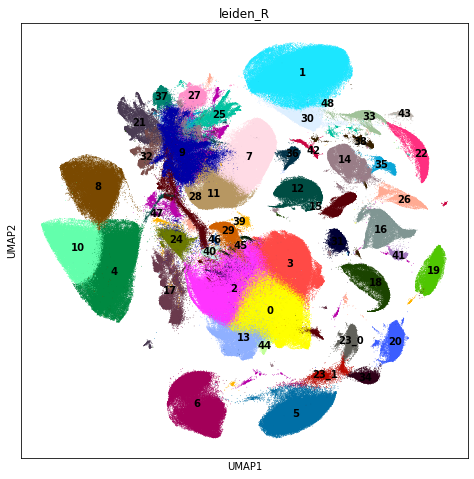

In [223]:
plt.rcParams['figure.figsize'] = (8, 8)

sc.pl.umap(adata, color=['leiden_R'], size=2,legend_loc = 'on data')



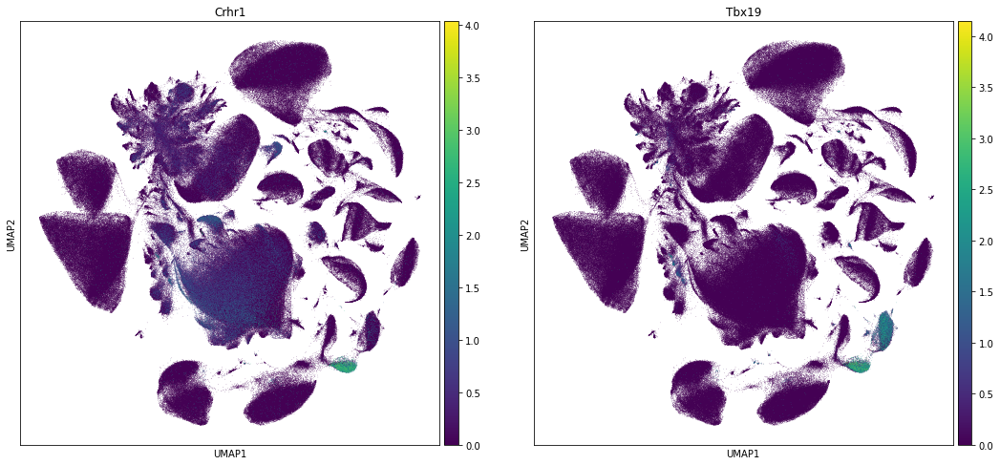

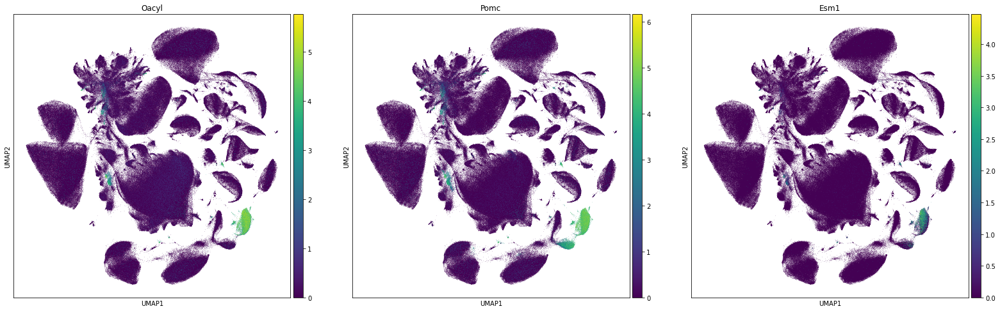

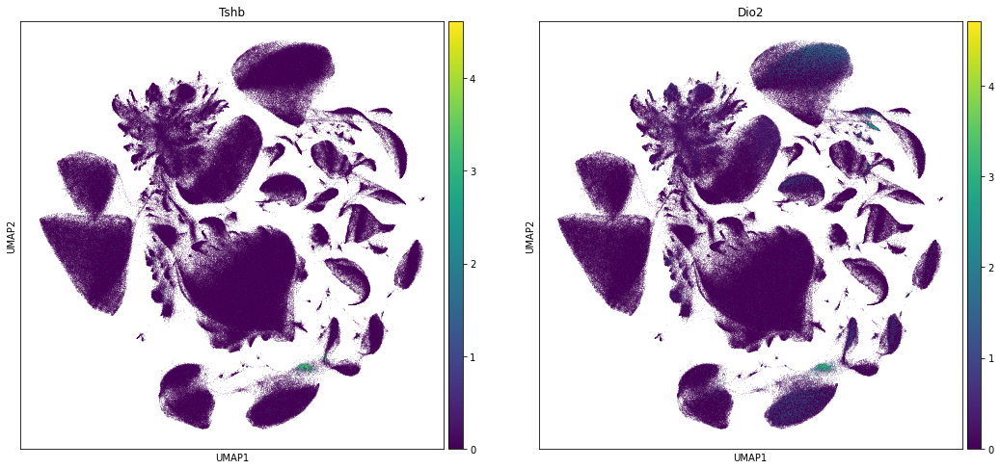

In [224]:
sc.pl.umap(adata, color=["Crhr1","Tbx19"], size=1) # corticotrope

sc.pl.umap(adata, color=["Oacyl","Pomc","Esm1"], size=1) # gonadotrope

sc.pl.umap(adata, color=["Tshb","Dio2"], size=1) # thyrotrope


# Assign celltypes to clusters

In [3]:
adata = sc.read_h5ad('/share/crsp/lab/seyedam/share/igvf_pipeline/IGVF_analysis/annotated_tissues/HypothalamusPituitary_annotated_updated.h5ad')


In [4]:
adata.obs.head()

,bc,bc1_sequence,bc2_sequence,bc3_sequence,subpool,bc1_well,bc2_well,bc3_well,Mouse_Tissue_ID,alias_tissue1,...,leiden,predictions,ryan_annotations,subtype,general_celltype,general_CL_ID,celltype,CL_ID,leiden_R,subtype_update
cellID,,,,,,,,,,,,,,,,,,,,,
D5_B1_A2_13A_igvf_012,AAACATCGAACAACCAGCTCTACT,GCTCTACT,AACAACCA,AAACATCG,13A,D5,B1,A2,046_NZOJ_10F_01,ali-mortazavi:046_NZOJ_10F_01_UBERON_0001898,...,6,L4_IT,NaN,lactotroph,neuroendocrine cell,CL:0000165,lactotroph,CL:0002311,6,lactotroph
D8_B9_A2_13A_igvf_012,AAACATCGACGCTCGACTATCATC,CTATCATC,ACGCTCGA,AAACATCG,13A,D8,B9,A2,046_NZOJ_10F_01,ali-mortazavi:046_NZOJ_10F_01_UBERON_0001898,...,6,L4_IT,NaN,lactotroph,neuroendocrine cell,CL:0000165,lactotroph,CL:0002311,6,lactotroph
D8_A12_A2_13A_igvf_012,AAACATCGAGTACAAGCTATCATC,CTATCATC,AGTACAAG,AAACATCG,13A,D8,A12,A2,046_NZOJ_10F_01,ali-mortazavi:046_NZOJ_10F_01_UBERON_0001898,...,6,L4_IT,NaN,lactotroph,neuroendocrine cell,CL:0000165,lactotroph,CL:0002311,6,lactotroph
D6_C3_A2_13A_igvf_012,AAACATCGAGTCACTAGTTACGTA,GTTACGTA,AGTCACTA,AAACATCG,13A,D6,C3,A2,046_NZOJ_10F_01,ali-mortazavi:046_NZOJ_10F_01_UBERON_0001898,...,16,Endothelial,NaN,endothelial cell,endothelial cell,CL:0000115,endothelial cell,CL:0000115,16,endothelial cell
D7_D11_A2_13A_igvf_012,AAACATCGCAAGACTACCTGTTGC,CCTGTTGC,CAAGACTA,AAACATCG,13A,D7,D11,A2,046_NZOJ_10F_01,ali-mortazavi:046_NZOJ_10F_01_UBERON_0001898,...,23,Meis2,NaN,thyrotroph,neuroendocrine cell,CL:0000165,thyrotroph,CL:0000476,23_1,thyrotroph


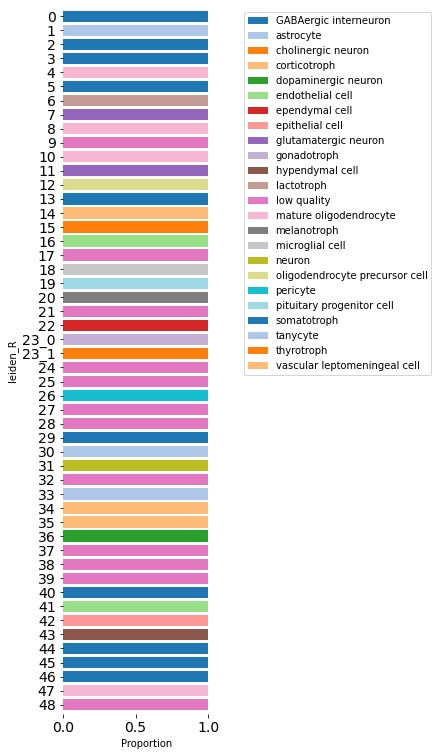

In [5]:
import matplotlib.pyplot as plt

m = adata.obs.groupby(['leiden_R']).size().to_frame()
grouped_data = adata.obs.groupby(['leiden_R', 'subtype']).size().unstack().fillna(0)
proportions = grouped_data.div(grouped_data.sum(axis=1), axis=0)
proportions = proportions.iloc[::-1]

n_colors = len(proportions.columns)
color_palette = plt.cm.tab20.colors[:n_colors]

ax = proportions.plot(kind='barh', stacked=True, figsize=(3, 13), width=0.8, color=color_palette)
plt.xlim(0, 1.15)

ax.tick_params(axis="x", labelsize=14)
ax.tick_params(axis="y", labelsize=14)
ax.set_xlabel("Proportion")

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

ax.grid(False)

plt.show()


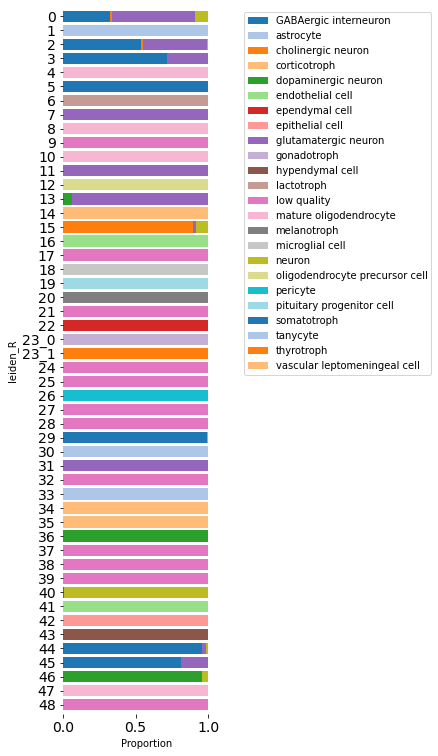

In [12]:
import matplotlib.pyplot as plt

m = adata.obs.groupby(['leiden_R']).size().to_frame()
grouped_data = adata.obs.groupby(['leiden_R', 'subtype_update']).size().unstack().fillna(0)
proportions = grouped_data.div(grouped_data.sum(axis=1), axis=0)
proportions = proportions.iloc[::-1]

n_colors = len(proportions.columns)
color_palette = plt.cm.tab20.colors[:n_colors]

ax = proportions.plot(kind='barh', stacked=True, figsize=(3, 13), width=0.8, color=color_palette)
plt.xlim(0, 1.15)

ax.tick_params(axis="x", labelsize=14)
ax.tick_params(axis="y", labelsize=14)
ax.set_xlabel("Proportion")

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

ax.grid(False)

plt.show()


In [10]:
neu = adata.obs[adata.obs['general_celltype'] == 'neuron']


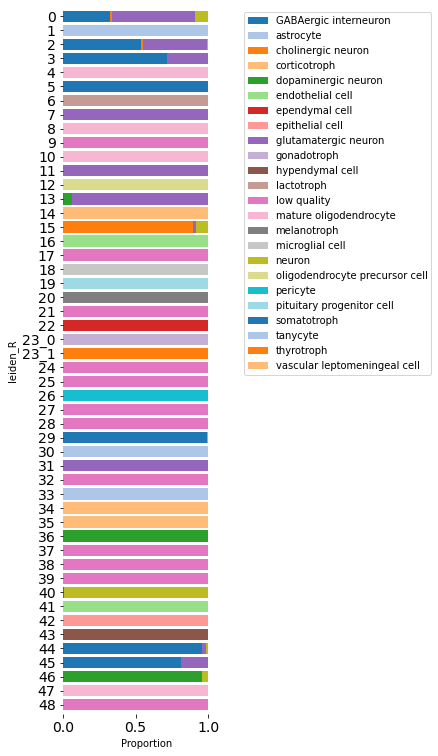

In [6]:
import matplotlib.pyplot as plt

m = adata.obs.groupby(['leiden_R']).size().to_frame()
grouped_data = adata.obs.groupby(['leiden_R', 'subtype_update']).size().unstack().fillna(0)
proportions = grouped_data.div(grouped_data.sum(axis=1), axis=0)
proportions = proportions.iloc[::-1]

n_colors = len(proportions.columns)
color_palette = plt.cm.tab20.colors[:n_colors]

ax = proportions.plot(kind='barh', stacked=True, figsize=(3, 13), width=0.8, color=color_palette)
plt.xlim(0, 1.15)

ax.tick_params(axis="x", labelsize=14)
ax.tick_params(axis="y", labelsize=14)
ax.set_xlabel("Proportion")

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

ax.grid(False)

plt.show()


/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


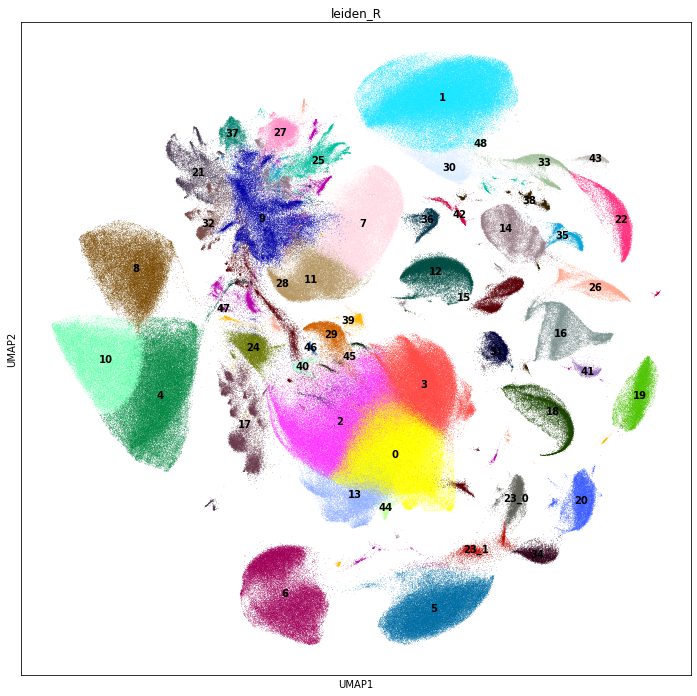

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


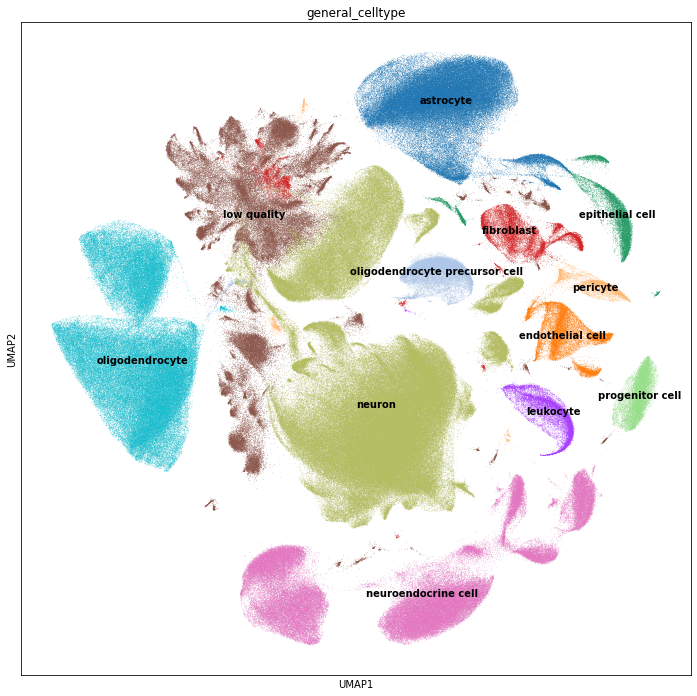

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


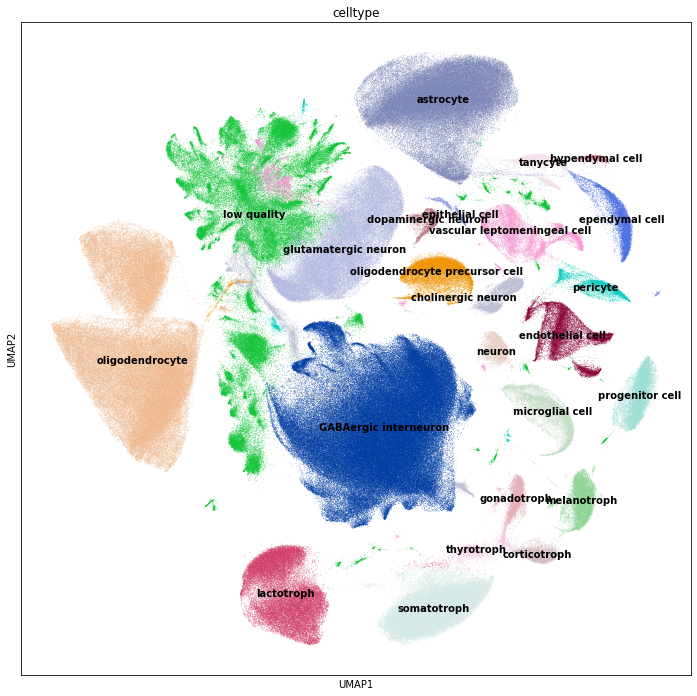

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


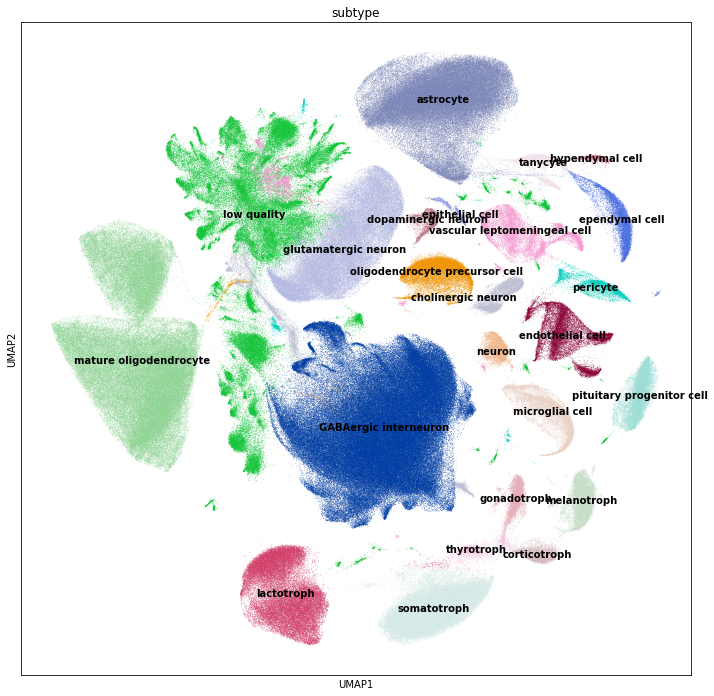

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


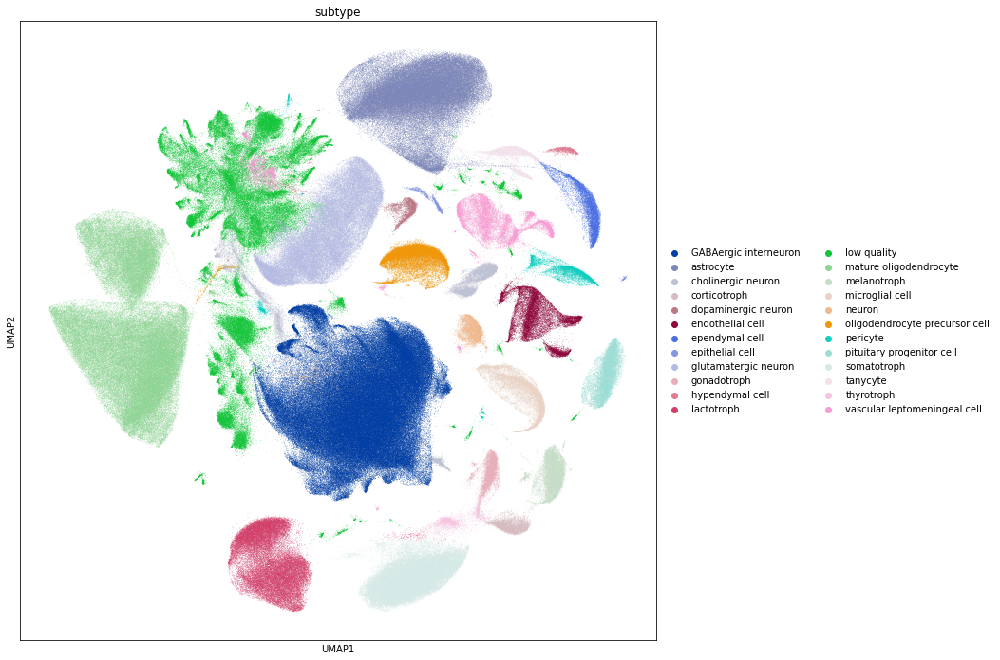

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


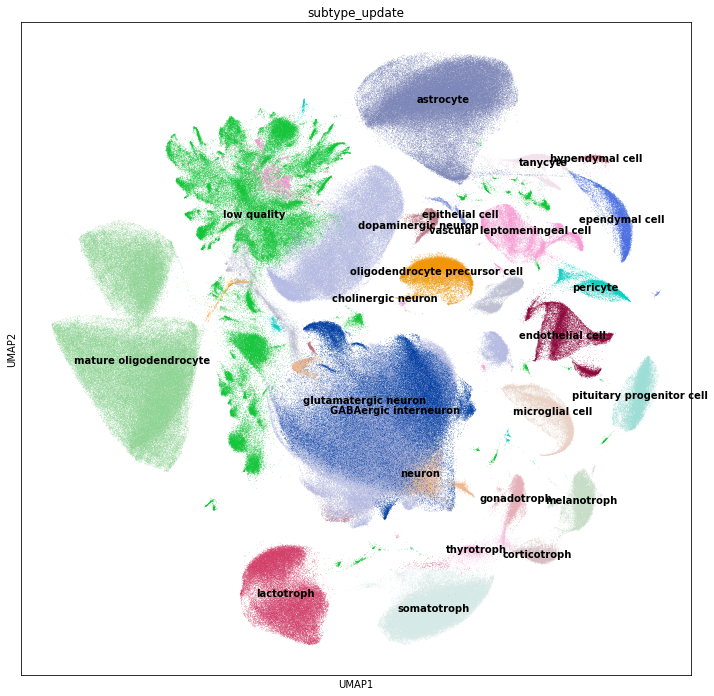

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


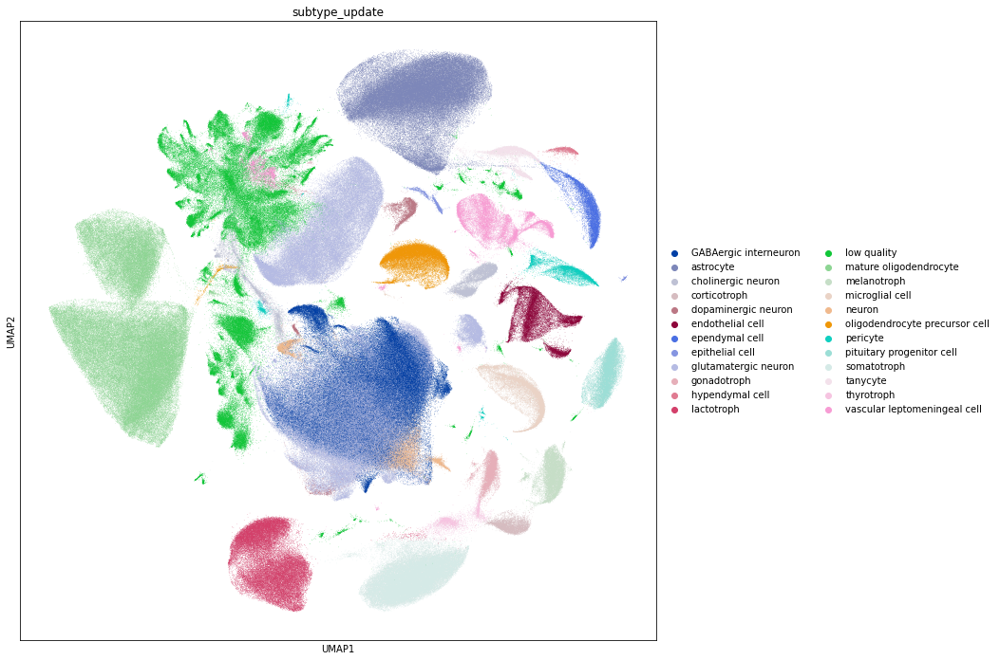

In [7]:
plt.rcParams['figure.figsize'] = (12, 12)
sc.pl.umap(adata, color=['leiden_R'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['general_celltype'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['celltype'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['subtype'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['subtype'], size=1)

sc.pl.umap(adata, color=['subtype_update'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['subtype_update'], size=1)



In [229]:
annots = pd.read_csv("HypothalamusPituitary_annotations.csv")
annots['leiden_R'] = annots['leiden_R'].astype(str)

annotation_dict = annots.groupby('leiden_R').head(1).set_index('leiden_R')['general_celltype'].to_dict()
adata.obs['general_celltype'] = adata.obs['leiden_R'].map(annotation_dict)
annotation_dict = annots.groupby('leiden_R').head(1).set_index('leiden_R')['general_CL_ID'].to_dict()
adata.obs['general_CL_ID'] = adata.obs['leiden_R'].map(annotation_dict)

annotation_dict = annots.groupby('leiden_R').head(1).set_index('leiden_R')['celltype'].to_dict()
adata.obs['celltype'] = adata.obs['leiden_R'].map(annotation_dict)
annotation_dict = annots.groupby('leiden_R').head(1).set_index('leiden_R')['CL_ID'].to_dict()
adata.obs['CL_ID'] = adata.obs['leiden_R'].map(annotation_dict)

annotation_dict = annots.groupby('leiden_R').head(1).set_index('leiden_R')['subtype'].to_dict()
adata.obs['subtype'] = adata.obs['leiden_R'].map(annotation_dict)



/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


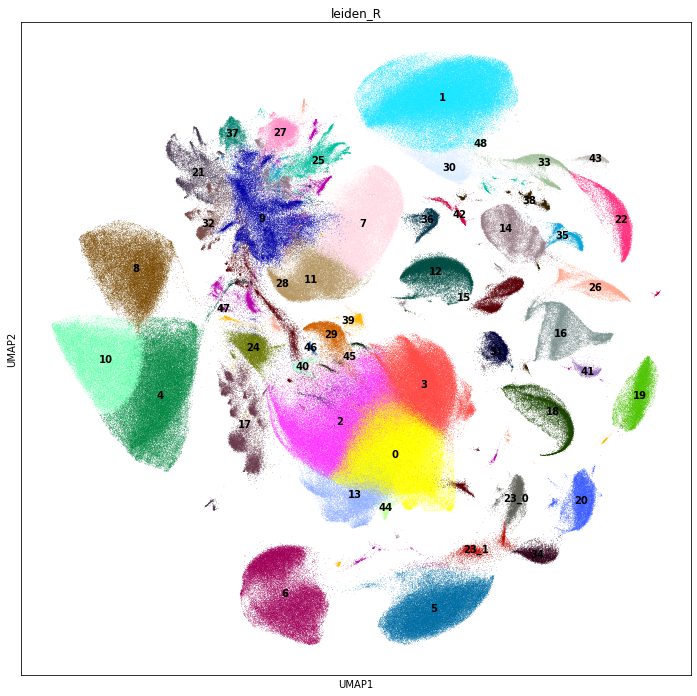

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


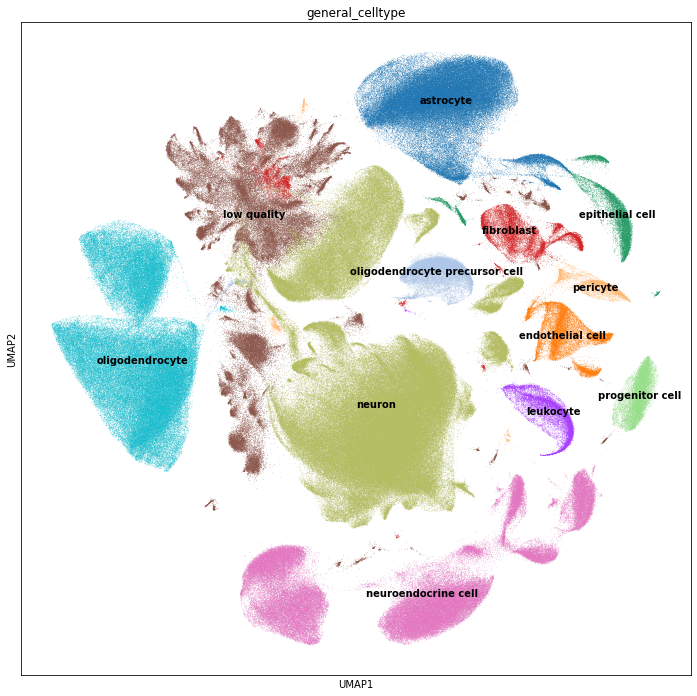

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


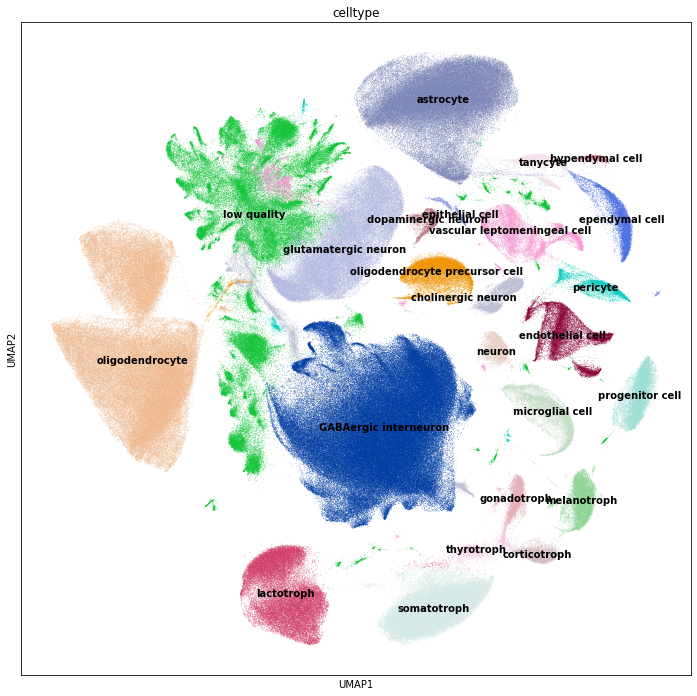

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


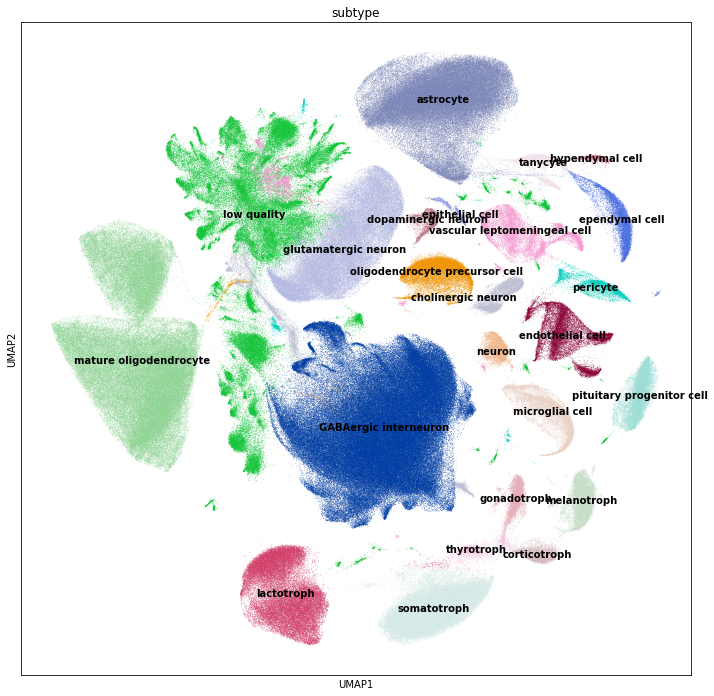

/opt/apps/python/3.8.0/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


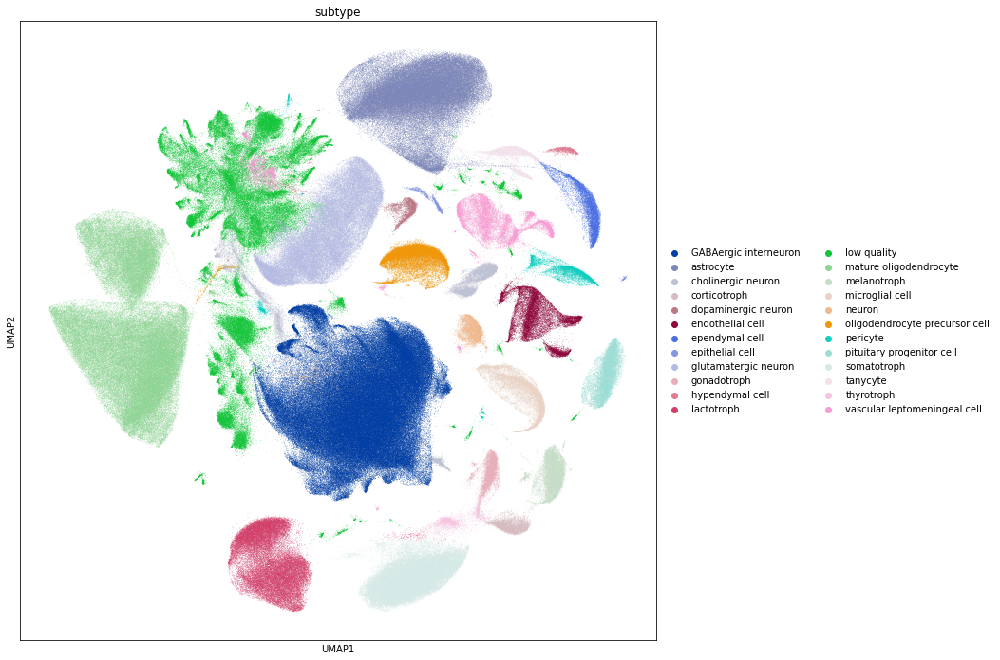

In [9]:
plt.rcParams['figure.figsize'] = (12, 12)
sc.pl.umap(adata, color=['leiden_R'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['general_celltype'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['celltype'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['subtype'], size=1, legend_loc = 'on data')
sc.pl.umap(adata, color=['subtype'], size=1)

/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


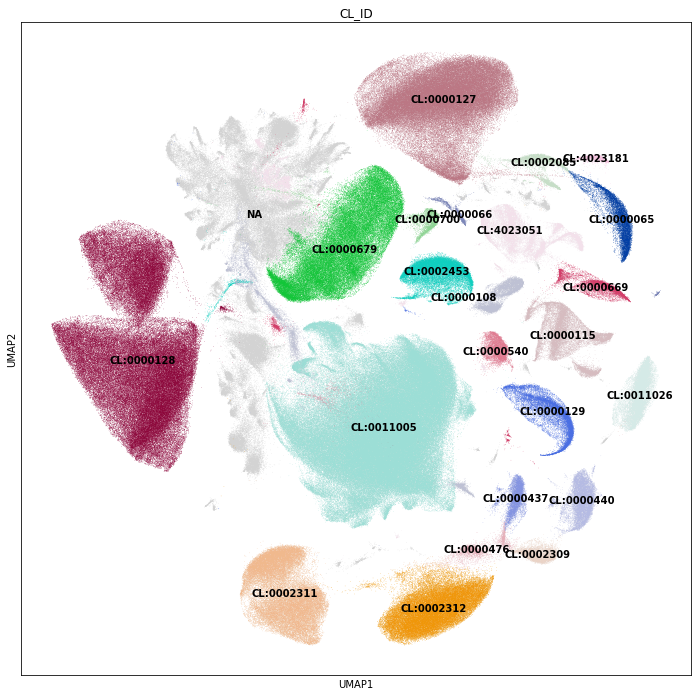

In [232]:
sc.pl.umap(adata, color=['CL_ID'], size=1, legend_loc = 'on data')


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


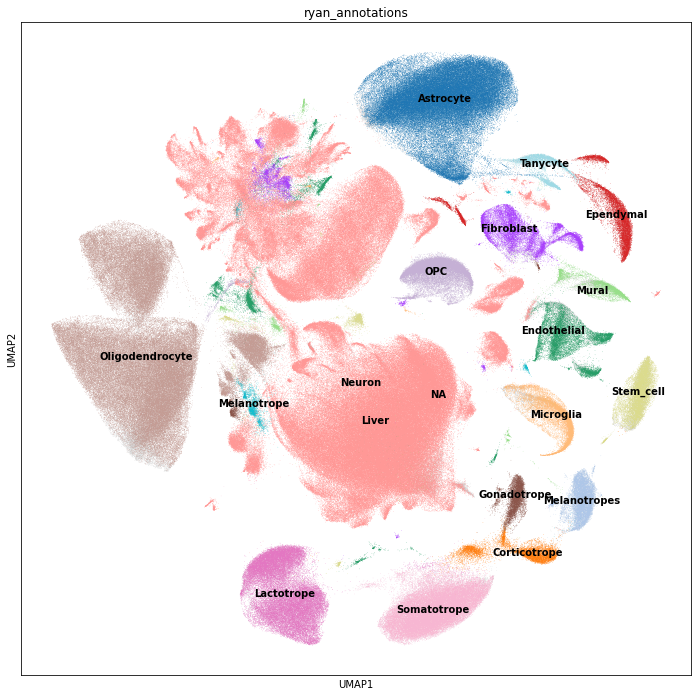

In [213]:
sc.pl.umap(adata, color=['ryan_annotations'], size=1, legend_loc = 'on data')


/Users/liz/opt/anaconda3/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


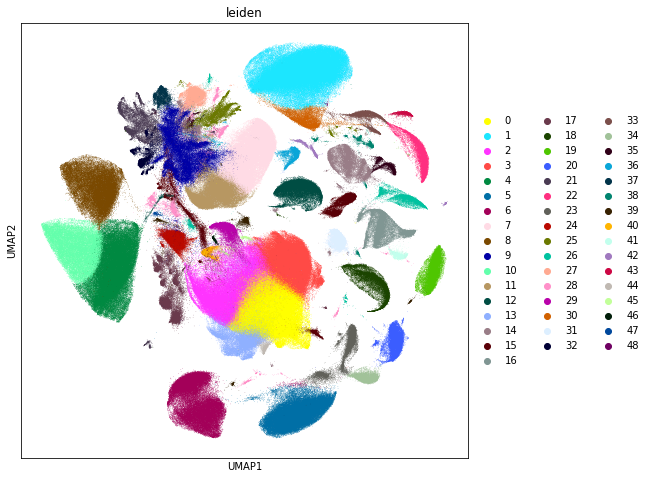

In [152]:
sc.pl.umap(adata, color=['leiden'], size=1)# legend_loc = 'on data')


In [234]:
adata.write_h5ad('../IGVF_analysis/annotated_tissues/HypothalamusPituitary_annotated.h5ad')


In [233]:
meta = adata.obs
meta.to_csv(f"../IGVF_analysis/annotated_tissues/HypothalamusPituitary_annotated_metadata.csv")

# Pseudobulk PCA


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import decoupler as dc
import anndata
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import random


<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [2]:
tissue = "HypothalamusPituitary"
adata = sc.read(f"../IGVF_analysis/annotated_tissues/{tissue}_annotated.h5ad")
adata = adata[(adata.obs['Genotype'] != "tie")]
adata = adata[~adata.obs['celltype'].isin(["low quality"])]


In [3]:
adata.obs['Mouse_Tissue_ID'] = adata.obs['Mouse_Tissue_ID'].astype(str)


/tmp/ipykernel_3426448/2200752215.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['Mouse_Tissue_ID'] = adata.obs['Mouse_Tissue_ID'].astype(str)


In [4]:
# adjust mouse_tissue_id
ms1 = ['B6J','AJ','WSBJ','129S1J']
ms2 = ['NODJ','PWKJ','NZOJ','CASTJ']

# Define a function to update 'Mouse_Tissue_ID' based on conditions
def update_mouse_tissue_id(row):
    if row['plate'] != 'igvf_012' and row['Column'] in [9, 10, 11, 12]:
        if row['Genotype'] in ms1:
            return row['Multiplexed_sample1']
        elif row['Genotype'] in ms2:
            return row['Multiplexed_sample2']
    return row['Mouse_Tissue_ID']

meta = adata.obs

# Apply the function to update the 'Mouse_Tissue_ID' column
meta['Mouse_Tissue_ID'] = meta.apply(update_mouse_tissue_id, axis=1)
adata.obs['Mouse_Tissue_ID'] = meta['Mouse_Tissue_ID']



In [5]:
import decoupler as dc

pdata = dc.get_pseudobulk(
    adata,
    sample_col='Mouse_Tissue_ID',
    groups_col=None,
    obs=adata.obs,
    layer='raw_counts',
    mode='sum',
    min_cells=10,
    min_counts=10000
)


In [6]:
for c in pdata.obs.columns:
        if pd.api.types.is_object_dtype(pdata.obs[c].dtype):
            pdata.obs[c] = pdata.obs[c].fillna('NA')

In [7]:
pdata.write_h5ad(f'../IGVF_analysis/pseudobulk/{tissue}_pseudobulk_raw.h5ad')


In [8]:
sc.pp.normalize_total(pdata, target_sum=1e4) # Counts per 10k
sc.pp.log1p(pdata)

sc.tl.pca(pdata, svd_solver='arpack', use_highly_variable = False)



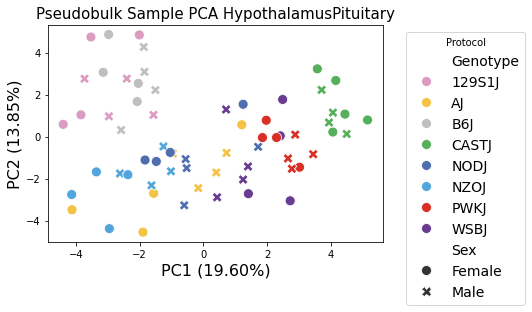

In [9]:
df = pd.DataFrame(pdata.obsm["X_pca"])
meta  = pdata.obs
df.set_index(meta['Mouse_Tissue_ID'], inplace=True)
merged_df = pd.merge(df, meta, left_index=True, right_on='Mouse_Tissue_ID')

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

geno_palette = ['#DA9CC1', '#F4C245', '#C0BFBF', '#55AF5B', '#4F6EAF', '#52A5DB', '#D83026', '#683C91']


sns.scatterplot(x=merged_df.iloc[:, 0], y=merged_df.iloc[:, 1], 
                hue=merged_df['Genotype'], 
                style=merged_df['Sex'], 
                s=100, 
                palette=geno_palette,
                alpha=1)  # Adjust transparency if needed

plt.xlabel("PC1", fontsize=16)
plt.ylabel("PC2", fontsize=16)
plt.title(f'Pseudobulk Sample PCA {tissue}', fontsize=15)

plt.legend(title='Protocol', fontsize=14, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(False)
pc1 = pdata.uns["pca"]["variance_ratio"][0]
pc2 = pdata.uns["pca"]["variance_ratio"][1]
plt.xlabel(f"PC1 ({pc1:.2%})", fontsize=16)
plt.ylabel(f"PC2 ({pc2:.2%})", fontsize=16)


plt.show()


# Pseudobulk subtype expression

In [ ]:
import scanpy as sc
import decoupler as dc
import pandas as pd


In [ ]:
tissue = "HypothalamusPituitary"
adata = sc.read(f"../IGVF_analysis/{tissue}_processed.h5ad")


In [ ]:
meta = pd.read_csv(f"../IGVF_analysis/annotated_tissues/{tissue}_annotated_metadata.csv")
cell_mapper = dict(zip(meta['cellID'], meta['subtype']))

adata.obs['subtype'] = adata.obs.index.map(cell_mapper)
mask = ~adata.obs['subtype'].isna()
adata = adata[mask]


In [ ]:
pdata = dc.get_pseudobulk(
    adata,
    sample_col="subtype",
    groups_col=None,
    obs=adata.obs,
    layer='raw_counts',
    mode='sum',
    min_cells=10,
    min_counts=10000
)

for c in pdata.obs.columns:
        if pd.api.types.is_object_dtype(pdata.obs[c].dtype):
            pdata.obs[c] = pdata.obs[c].fillna('NA')
            
pdata.write_h5ad(f'../IGVF_analysis/pseudobulk/{tissue}_pseudobulk_subtype_sum.h5ad')


In [ ]:
pdata = dc.get_pseudobulk(
    adata,
    sample_col="subtype",
    groups_col=None,
    obs=adata.obs,
    layer='raw_counts',
    mode='median',
    min_cells=10,
    min_counts=10000
)

for c in pdata.obs.columns:
        if pd.api.types.is_object_dtype(pdata.obs[c].dtype):
            pdata.obs[c] = pdata.obs[c].fillna('NA')
            
pdata.write_h5ad(f'../IGVF_analysis/pseudobulk/{tissue}_pseudobulk_subtype_median.h5ad')


In [ ]:
pdata = dc.get_pseudobulk(
    adata,
    sample_col="subtype",
    groups_col=None,
    obs=adata.obs,
    layer='raw_counts',
    mode='mean',
    min_cells=10,
    min_counts=10000
)

for c in pdata.obs.columns:
        if pd.api.types.is_object_dtype(pdata.obs[c].dtype):
            pdata.obs[c] = pdata.obs[c].fillna('NA')
            

pdata.write_h5ad(f'../IGVF_analysis/pseudobulk/{tissue}_pseudobulk_subtype_mean.h5ad')
